In [2]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Préliminaires

In [24]:
def f_1(X):
    return np.sum(X**2)

def f_2(X):
    n = len(X)
    s = 0
    for i in range(1, n+1):
        s += (100**((i-1)/(n-1))*X[i-1])**2
    return s

def f_3(X):
    n = len(X)
    s = 10*n
    for x in X:
        s += x**2 - 10*np.cos(2*np.pi*x)
    return s

def f_4(X):
    n = len(X)
    s = 0
    for i in range(0,n-1):
        s += 100*(X[i]**2 -X[i+1])**2 + (X[i] - 1)**2
        
    return s

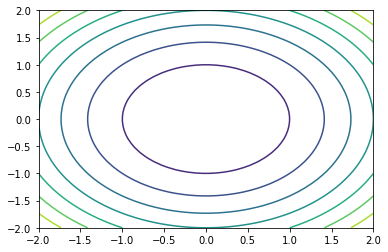

In [182]:
x = np.linspace(-2, 2, 50) 
y = np.linspace(-2, 2, 50)
X, Y = np.meshgrid(x, y)
Z = []
for i in range(len(X)):
    l = []
    for j in range(len(Y)):
        l.append(f_1(np.array([X[i,j], Y[i,j]])))
    Z.append(l)
plt.contour(X, Y, Z)

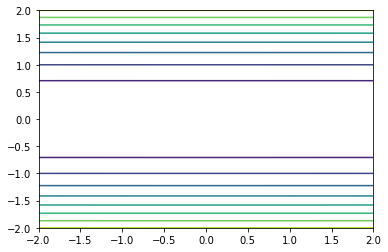

In [13]:
x = np.linspace(-2, 2, 50) 
y = np.linspace(-2, 2, 50)
X, Y = np.meshgrid(x, y)
Z = []
for i in range(len(X)):
    l = []
    for j in range(len(Y)):
        l.append(f_2(np.array([X[i,j], Y[i,j]])))
    Z.append(l)
plt.contour(X, Y, Z)

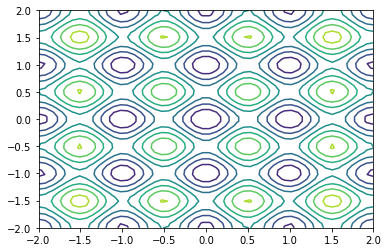

In [14]:
x = np.linspace(-2, 2, 50) 
y = np.linspace(-2, 2, 50)
X, Y = np.meshgrid(x, y)
Z = []
for i in range(len(X)):
    l = []
    for j in range(len(Y)):
        l.append(f_3(np.array([X[i,j], Y[i,j]])))
    Z.append(l)
plt.contour(X, Y, Z)

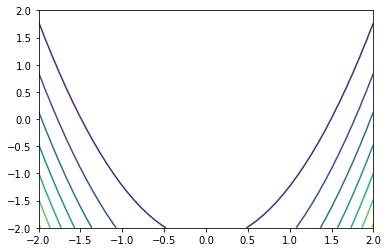

In [48]:
x = np.linspace(-2, 2, 50) 
y = np.linspace(-2, 2, 50)
X, Y = np.meshgrid(x, y)
Z = []
for i in range(len(X)):
    l = []
    for j in range(len(Y)):
        l.append(f_4(np.array([X[i,j], Y[i,j]])))
    Z.append(l)
    
plt.contour(X, Y, Z)

In [196]:
def random_search(f, n, x_0, t_max=100):
    x1 = np.array(x_0)
    z = []
    
    t = 0
    while t < t_max:
        t += 1
        
        u = np.random.uniform(-5, 5, n)
        z1 = f(x1)
        z2 = f(u)
        
        if z2 < z1:
            z += [z2]
            x1 = u
        else:
            z += [z1]
                
    return x1, z

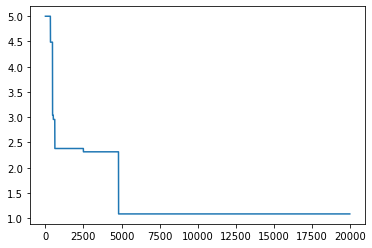

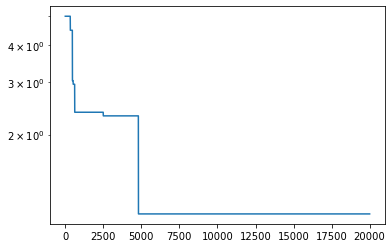

In [201]:
x, z = random_search(f_1, 5, [1, 1, 1, 1, 1], t_max=20000)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

# 2. (1+1)-ES avec step-size constant

In [170]:
def ES_fixed_step_size(f, size, start, sig, t_max):
    x = start
    t = 0
    z = []
    while t < t_max:
        t += 1
        xx = x + sig * np.random.normal(0, 1, size)
        
        z1 = f(x)
        z2 = f(xx)
        
        if z2 < z1:
            z += [z2]
            x = xx
        else:
            z += [z1]
            
    return x, z

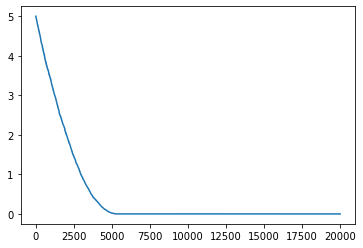

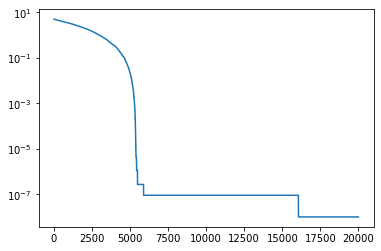

In [93]:
x = np.array([1,1,1,1,1])
x, z = ES_fixed_step_size(f_1, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

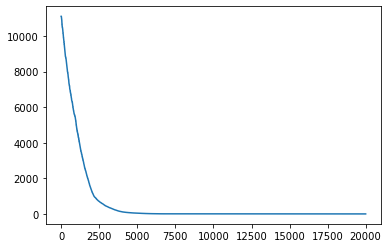

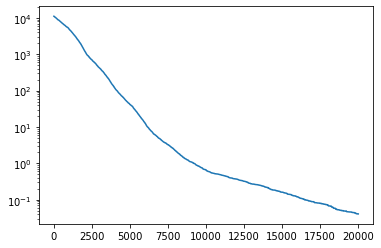

In [95]:
x = np.array([1,1,1,1,1])
x, z = ES_fixed_step_size(f_2, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

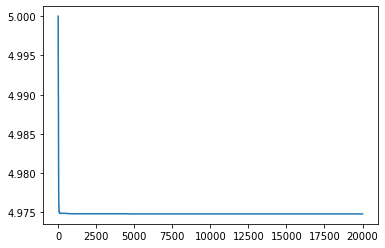

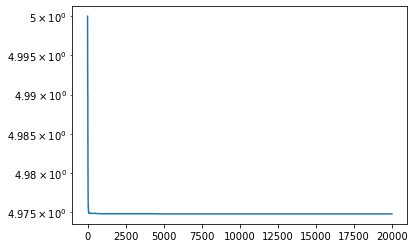

In [96]:
x = np.array([1,1,1,1,1])
x, z = ES_fixed_step_size(f_3, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

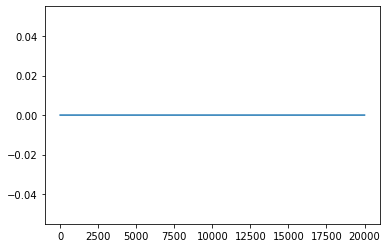

/opt/anaconda/envs/PJI/lib/python3.9/site-packages/ipykernel/pylab/backend_inline.py:183: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  for label in axis.get_ticklabels()])


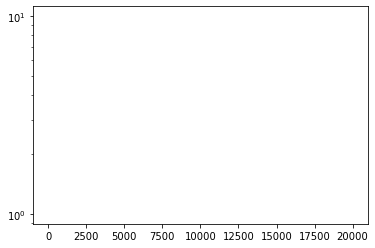

In [97]:
x = np.array([1,1,1,1,1])
x, z = ES_fixed_step_size(f_4, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

# 3. (1+1)-ES avec step-size adaptatif

In [169]:
def ES_adaptatif_step_size(f, size, start, sig, t_max):
    x = start
    t = 0
    z = []
    while t < t_max:
        t += 1
        xx = x + sig * np.random.normal(0, 1, size)
        
        z1 = f(x)
        z2 = f(xx)
        
        if z2 < z1:
            z += [z2]
            x = xx
            sig = 1.5*sig
        else:
            z += [z1]
            sig = 1.5**(-.25)*sig
            
    return x, z

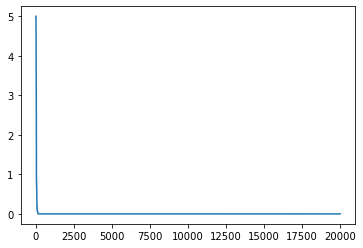

/opt/anaconda/envs/PJI/lib/python3.9/site-packages/matplotlib/ticker.py:1192: RuntimeWarning: divide by zero encountered in double_scalars
  coeff = round(x / b ** exponent)


OverflowError: cannot convert float infinity to integer

<Figure size 432x288 with 1 Axes>

In [100]:
x = np.array([1,1,1,1,1])
x, z = ES_adaptatif_step_size(f_1, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

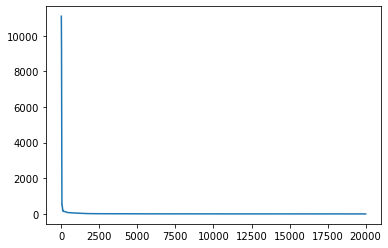

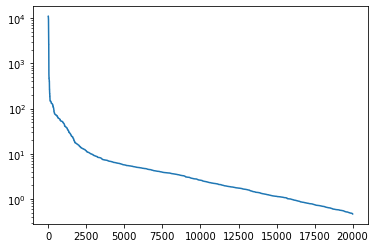

In [101]:
x = np.array([1,1,1,1,1])
x, z = ES_adaptatif_step_size(f_2, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

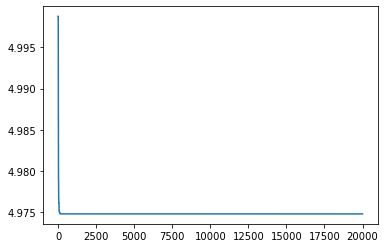

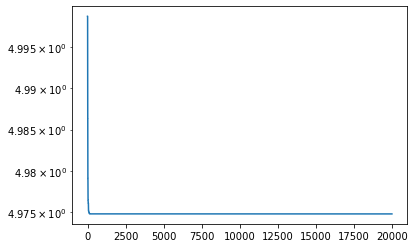

In [104]:
x = np.array([1,1,1,1,1])
x, z = ES_adaptatif_step_size(f_3, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

In [105]:
def f_5(X):
    return f_1(X)**(.25)

def f_6(X):
    return f_2(X)**(.25)

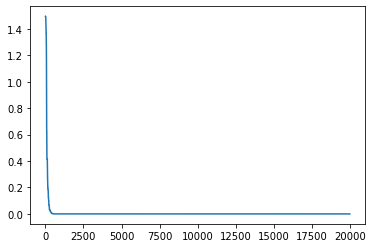

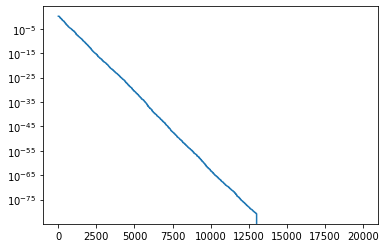

In [106]:
x = np.array([1,1,1,1,1])
x, z = ES_adaptatif_step_size(f_5, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

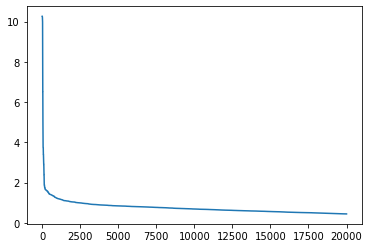

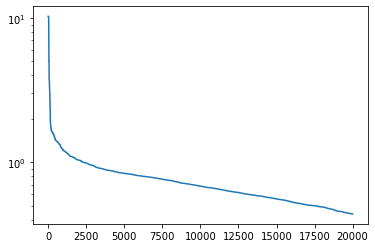

In [107]:
x = np.array([1,1,1,1,1])
x, z = ES_adaptatif_step_size(f_6, 5, x, .001, 5, 2*10**4)

plt.plot(np.arange(len(z)),z)
plt.show()

plt.semilogy(np.arange(len(z)),z)
plt.show()

In [176]:
def campaign(strat, f, size, start, sig, t_max):
    if strat == random_search:
        x, z = strat(f, size, start, t_max)
    else:
        x, z = strat(f, size, start, sig, t_max)
            
    return x, z

def do_campaign(strats, fs, size, starts, sigs, t_maxs, verbose=False):
    i = 0
    for s in strats:
        for f in fs:            
            for strt in starts:
                for sig in sigs:
                    for t in t_maxs:
                        i += 1
                        if verbose:
                            print("do_campaign", i, ": strat:", str(s), ", func: ", str(f), ", size:", size, ", start:", strt, ", sig:", sig, ", t_max:", t)
                            
                        x, z = campaign(s, f, size, strt, sig, t)
                        plt.semilogy(np.arange(len(z)),z)
                        plt.title("func:" + str(f) + ", strt:" + str(strt) + ", sig:" + str(sig) + ", t:" + str(t))
                        plt.show()

do_campaign 1 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 1e-05 , t_max: 10


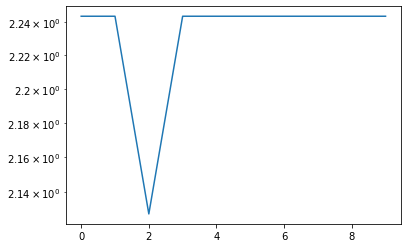

do_campaign 2 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 1e-05 , t_max: 50


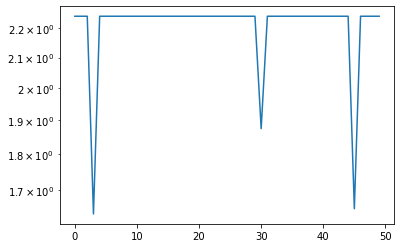

do_campaign 3 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 1e-05 , t_max: 100


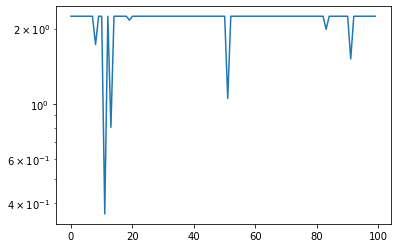

do_campaign 4 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 1e-05 , t_max: 500


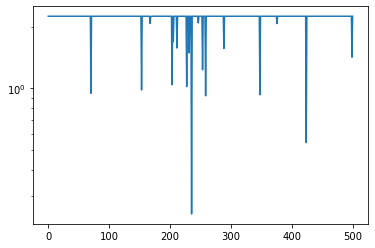

do_campaign 5 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 1e-05 , t_max: 1000


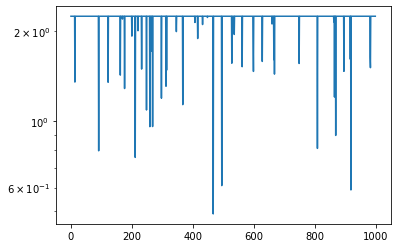

do_campaign 6 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.0001 , t_max: 10


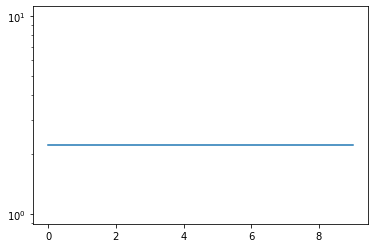

do_campaign 7 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.0001 , t_max: 50


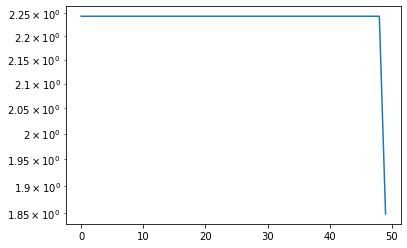

do_campaign 8 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.0001 , t_max: 100


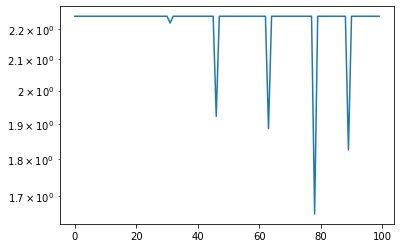

do_campaign 9 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.0001 , t_max: 500


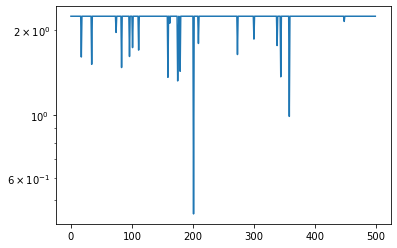

do_campaign 10 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.0001 , t_max: 1000


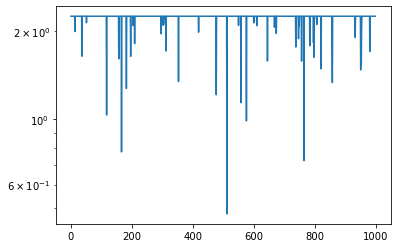

do_campaign 11 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.001 , t_max: 10


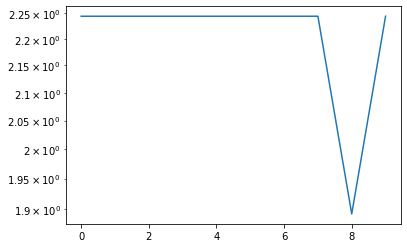

do_campaign 12 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.001 , t_max: 50


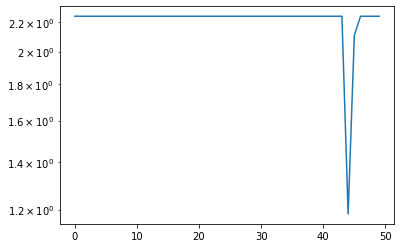

do_campaign 13 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.001 , t_max: 100


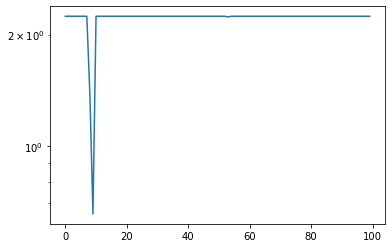

do_campaign 14 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.001 , t_max: 500


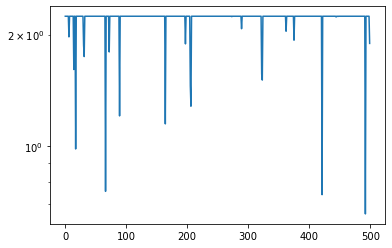

do_campaign 15 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.001 , t_max: 1000


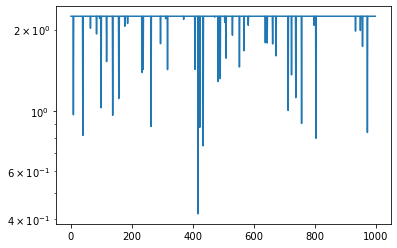

do_campaign 16 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.01 , t_max: 10


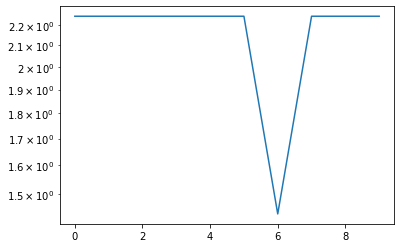

do_campaign 17 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.01 , t_max: 50


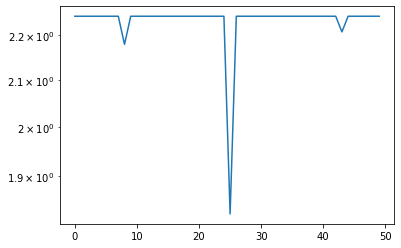

do_campaign 18 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.01 , t_max: 100


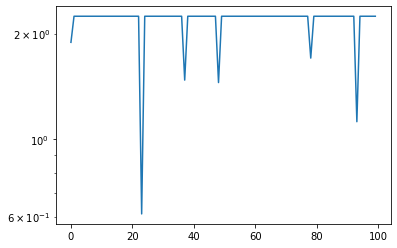

do_campaign 19 : strat: <function random_search at 0x7f26433f5ee0> , func:  <function f_1 at 0x7f264861fee0> , size: 5 , start: [ 88 111   9 461 454] , sig: 0.01 , t_max: 500


KeyboardInterrupt: 

In [165]:
strats = [random_search, ES_adaptatif_step_size, ES_fixed_step_size]
fs = [f_1, f_2, f_3, f_4, f_5, f_6]
size = 5
starts = np.random.randint(1,500,(10,size))
sigs = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
t_maxs = [10, 50, 100, 500, 1000]
do_campaign(strats, fs, size, starts, sigs, t_maxs)

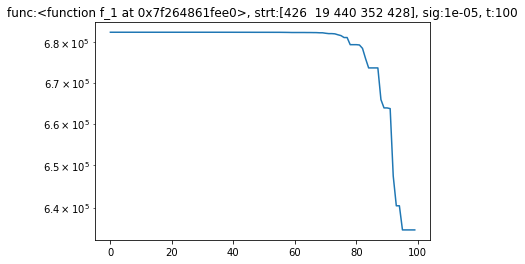

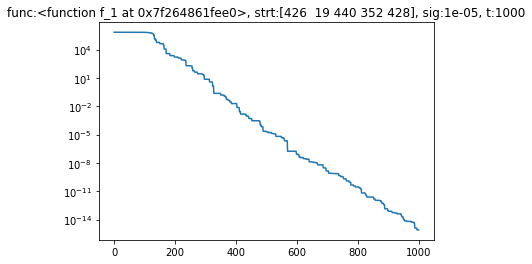

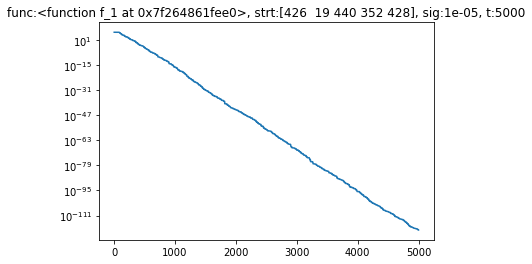

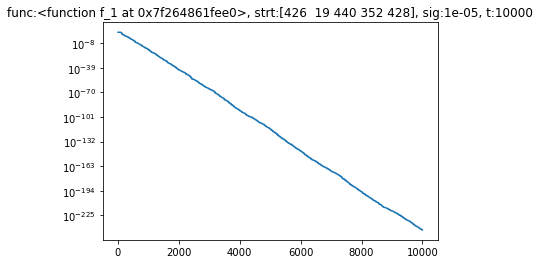

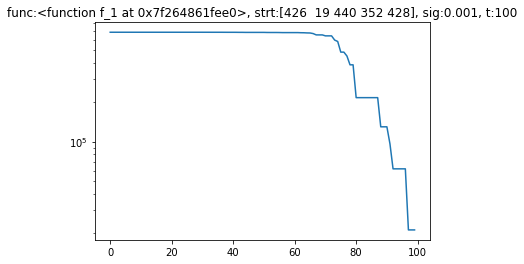

...

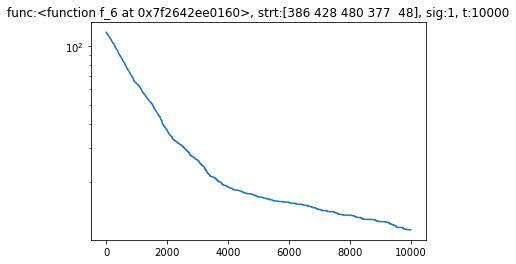

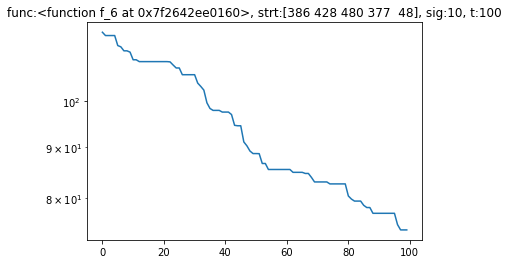

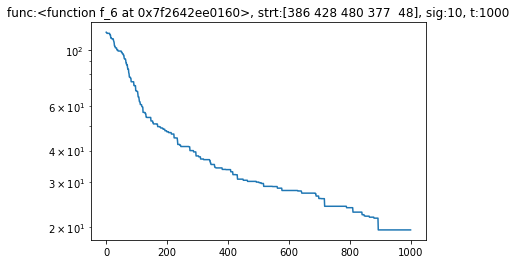

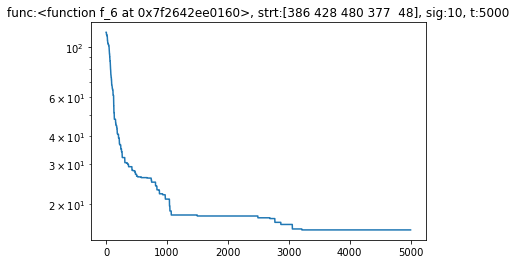

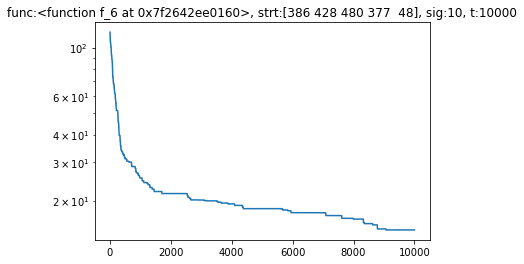

In [180]:
strats = [ES_adaptatif_step_size, ES_fixed_step_size]
fs = [f_1, f_2, f_3, f_4, f_5, f_6]
size = 5
starts = np.random.randint(1,500,(5,size))
sigs = [1e-5, 1e-3, 1e-1, 1, 10]
t_maxs = [100, 1000, 5000, 10000]
do_campaign(strats, fs, size, starts, sigs, t_maxs)